| ![EEW logo](https://github.com/edgi-govdata-archiving/EEW-Image-Assets/blob/master/Jupyter%20instructions/eew.jpg?raw=true) | ![EDGI logo](https://github.com/edgi-govdata-archiving/EEW-Image-Assets/blob/master/Jupyter%20instructions/edgi.png?raw=true) |
|---|---|

#### This notebook is licensed under GPL 3.0. Please visit our Github repo for more information: https://github.com/edgi-govdata-archiving/ECHO-COVID19
#### The notebook was collaboratively authored by the Environmental Data & Governance Initiative (EDGI) following our authorship protocol: https://docs.google.com/document/d/1CtDN5ZZ4Zv70fHiBTmWkDJ9mswEipX6eCYrwicP66Xw/
#### For more information about this project, visit https://www.environmentalenforcementwatch.org/

# Tracking EPA's COVID-19 non-enforcement policy
In late March 2020, EPA released a memo announcing that it would not penalize regulated industries that fail to meet their monitoring and reporting requirements due to COVID-19. Specifically EPA has said that it:

> "is not seeking penalties for noncompliance only in circumstances that involve routine monitoring and reporting requirements, if, on a case-by-case basis, EPA agrees that such noncompliance was caused by the COVID-19 pandemic."

This may have a number of public and environmental health impacts if facilities respond by increasing their emissions and discharges. Our response to this memo states that the EPA’s COVID-19 leniency is [a “free pass to pollute.](https://envirodatagov.org/epas-covid-19-leniency-is-a-free-pass-to-pollute/)”

Using this notebook, you can track how facilities' releases—as well as monitoring and reporting—of air and water hazards has changed over the past few months, compared to previous years. 

There are three scenarios we may see playing out:

_Monitoring and reporting violations_
- 1. **Facilities that do *not* report** (we can track this)....**but do still meet their permit limits** (yet we can't know this specifically, precisely because they didn't report)
- 2. **Facilities that do *not* report** (we can track this)....**and actually exceed their limits** (yet we can't know this specifically, precisely because they didn't report)

_Environmental violations_
- 3. **Facilities that do meet their reporting obligations** BUT they **report having exceeded their permitted limits**. In this case, we can also track whether EPA takes any enforcement action.

We may also see facilities that both meet their reporting obligations and do not exceed their permitted limits. These facilities may still pose a risk to community and environmental health but are not the focus of this investigation. Please see…

This investigation relies upon data from the EPA’s Enforcement & Compliance History Online (ECHO), the primary open data portal supplied by the EPA, and a major basis for EPA’s decisions around enforcement. Please see EPA’s “About the Data” page for known limitations on the data’s quality and completeness. Link to data source (https://echo.epa.gov/tools/data-downloads#downloads) and limitations (https://echo.epa.gov/resources/echo-data/about-the-data)

Organization of this notebook:
 - Air emissions
 - Water discharges from major sources 
 - Water quality monitoring and reporting violations
---

## How to Run this Notebook
* If you click on a gray **code** cell, a little “play button” arrow appears on the left. If you click the play button, it will run the code in that cell (“**running** a cell”). The button will animate. When the animation stops, the cell has finished running.
![Where to click to run the cell](https://github.com/edgi-govdata-archiving/EEW-Image-Assets/blob/master/Jupyter%20instructions/pressplay.JPG?raw=true)
* You may get a warning that the notebook was not authored by Google. We know, we authored them! It’s okay. Click “Run Anyway” to continue. 
![Error Message](https://github.com/edgi-govdata-archiving/EEW-Image-Assets/blob/master/Jupyter%20instructions/warning-message.JPG?raw=true)
* Run all of the cells in a Notebook to make a complete report. Please feel free to look at and **learn about each result as you create it**!

---

## Setup
Here we load some helper code to get us going.

In [ ]:
!git clone https://github.com/edgi-govdata-archiving/ECHO_modules.git -b database-views
!git clone https://github.com/edgi-govdata-archiving/ECHO-COVID19.git -b postresql_migrate
    
# Import code libraries
import urllib.parse
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import requests
import csv
import datetime
import folium
from folium.plugins import FastMarkerCluster
import ipywidgets as widgets
from pandas.errors import EmptyDataError

Cloning into 'ECHO_modules'...
remote: Enumerating objects: 55, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (41/41), done.
remote: Total 55 (delta 17), reused 42 (delta 12), pack-reused 0
Unpacking objects: 100% (55/55), done.
Cloning into 'ECHO-COVID19'...
remote: Enumerating objects: 51, done.
remote: Counting objects: 100% (51/51), done.
remote: Compressing objects: 100% (40/40), done.
remote: Total 234 (delta 27), reused 23 (delta 11), pack-reused 183
Receiving objects: 100% (234/234), 25.39 MiB | 9.67 MiB/s, done.
Resolving deltas: 100% (131/131), done.


In [ ]:
%run ECHO-COVID19/utilities.py
%run ECHO_modules/DataSet.py

## Set the timeframe
We'll look at trends for March and April 2020, corresponding to the early phase of the COVID pandemic and EPA's response to it, and compare them to previous Marches and Aprils.

In [ ]:
mnth_name="March and April"

## Are facilities monitoring their air emissions?
Stack tests involve measuring the volume of pollutants coming out of the facility's smokestack.

The following cell will grab EPA data on facility stack tests for every one of the Marches and Aprils on record (up to 19 years ago). Some pollutant releases may be seasonal, so by looking only at March and April, we can account for this variation and ensure an apples-to-apples comparison.

We will only look at data from 2001 on, as EPA notes that its data systems prior to that year are incomplete and hence "unknown."

In [ ]:
# Use SQL to search for and select the data about air stack tests
stack_data = None
full_stack_data = None
try:
    sql = 'select * from \"ICIS-AIR_STACK_TESTS\"'

    # Download the data from that URL
    full_stack_data = get_data( sql, 'pgm_sys_id' )
except EmptyDataError:
    print( "No data found")

if ( full_stack_data is not None ):
    full_stack_data["ACTUAL_END_DATE"]= pd.to_datetime(full_stack_data["ACTUAL_END_DATE"], format="%m/%d/%Y", errors = 'coerce') 
    full_stack_data['month'] = pd.DatetimeIndex(full_stack_data["ACTUAL_END_DATE"]).month

    stack_data = full_stack_data[ (full_stack_data['month'] == 3) | (full_stack_data['month'] == 4) ].copy()

# This is your data!
stack_data

select * from "ICIS-AIR_STACK_TESTS"
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%2A+from+%22ICIS-AIR_STACK_TESTS%22&pg


,PGM_SYS_ID,ACTIVITY_ID,COMP_MONITOR_TYPE_CODE,COMP_MONITOR_TYPE_DESC,STATE_EPA_FLAG,ACTUAL_END_DATE,POLLUTANT_CODES,POLLUTANT_DESCS,AIR_STACK_TEST_STATUS_CODE,AIR_STACK_TEST_STATUS_DESC,month
6,CT0000000900300005,3400331189,CST,Stack Test,S,2007-04-26,Mercury,NaN,PSS,Pass,4.0
7,CT0000000900300005,3400331252,CST,Stack Test,S,2009-04-28,TOTAL PARTICULATE MATTER,NaN,PSS,Pass,4.0
8,CT0000000900300005,3400331300,CST,Stack Test,S,2009-04-28,NITROGEN OXIDES NO2,NaN,PSS,Pass,4.0
9,CT0000000900300005,3400331331,CST,Stack Test,S,2010-04-28,Mercury,NaN,PSS,Pass,4.0
10,CT0000000900300005,3400331352,CST,Stack Test,S,2011-04-28,Mercury,NaN,PSS,Pass,4.0
...,...,...,...,...,...,...,...,...,...,...,...
453701,WANCA0005305700005,3601666807,CST,Stack Test,L,2018-03-20,NaN,NaN,PSS,Pass,3.0
453707,IA0000001901700030,3600399426,CST,Stack Test,S,2015-04-29,NaN,NaN,PSS,Pass,4.0
453717,IL000097190AAE,3601478216,CST,Stack Test,S,2018-04-30,NaN,NaN,PSS,Pass,4.0
453720,AK0000000229000002,3600827835,CST,Stack Test,S,2015-04-02,NaN,NaN,PSS,Pass,4.0


#### Chart stack tests

The height of each bar will indicate how many tests there were, while the orange line will show us the average number of these since 2001 and the pink line indicates the average for the past three years.

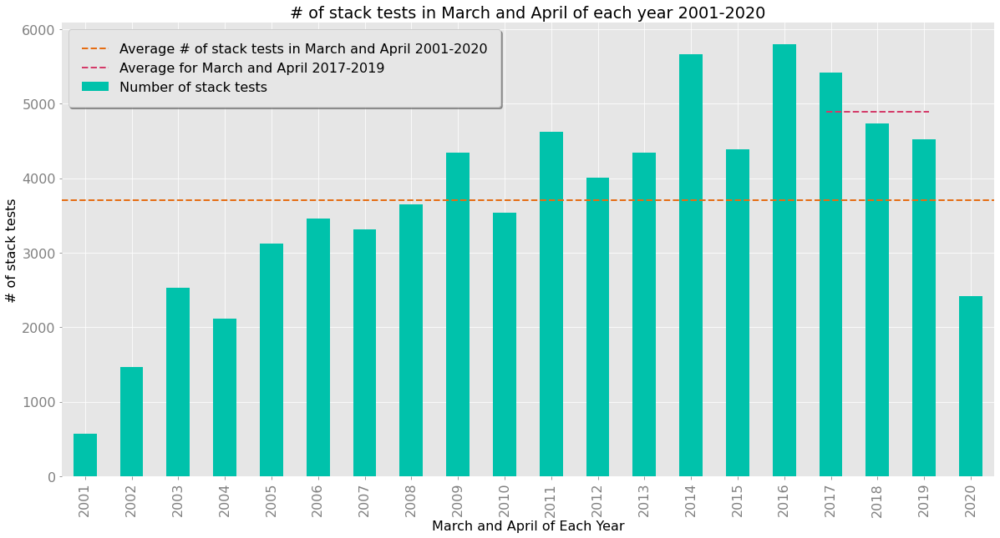

In [ ]:
charter(stack_data, 'ACTUAL_END_DATE', "%m/%d/%Y", mnth_name, 'STATE_EPA_FLAG', 
        "Number of stack tests", "air_monitoring.csv", "# of stack tests", 
        "count")

## Are facilities being inspected?
Stack tests may not be happening, but regulators could go in and inspect facilities. Are they conducting inspections?
#### Get the data

In [ ]:
eval_data = None
try:
    sql = 'select * from "ICIS-AIR_FCES_PCES" where "ACTUAL_END_DATE" like \'03-%\' or "ACTUAL_END_DATE" like \'04-%\''

    eval_data = get_data( sql, "PGM_SYS_ID" )
except EmptyDataError:
    print( "No data found")
eval_data

select * from "ICIS-AIR_FCES_PCES" where "ACTUAL_END_DATE" like '03-%' or "ACTUAL_END_DATE" like '04-%'
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%2A+from+%22ICIS-AIR_FCES_PCES%22+where+%22ACTUAL_END_DATE%22+like+%2703-%25%27+or+%22ACTUAL_END_DATE%22+like+%2704-%25%27&pg


,ACTIVITY_ID,STATE_EPA_FLAG,ACTIVITY_TYPE_CODE,ACTIVITY_TYPE_DESC,COMP_MONITOR_TYPE_CODE,COMP_MONITOR_TYPE_DESC,ACTUAL_END_DATE,PROGRAM_CODES
PGM_SYS_ID,,,,,,,,
020000003400700057,3400549169,E,INS,Inspection/Evaluation,PCE,PCE On-Site,03-13-1980,CAASIP
020000003400700107,3400549139,E,INS,Inspection/Evaluation,PCE,PCE On-Site,03-26-1980,CAASIP
020000003400700108,3400557727,E,INS,Inspection/Evaluation,POR,PCE On-Site Record/Report Review,03-11-1993,CAASIP
020000003400700285,3400548717,E,INS,Inspection/Evaluation,POR,PCE On-Site Record/Report Review,03-04-1993,CAACFC
020000003400700290,3400557729,E,INS,Inspection/Evaluation,PCE,PCE On-Site,03-03-1993,CAACFC
...,...,...,...,...,...,...,...,...
VA0000005108900035,3401035746,S,INS,Inspection/Evaluation,PFF,PCE Off-Site,04-11-2006,"CAASIP, CAATVP"
VA0000005108900035,3401035747,S,INS,Inspection/Evaluation,PFF,PCE Off-Site,04-12-2006,"CAAMACT, CAASIP, CAATVP"
VA0000005108900035,3401035764,S,INS,Inspection/Evaluation,PFF,PCE Off-Site,03-02-2007,"CAASIP, CAATVP"


#### Chart inspections

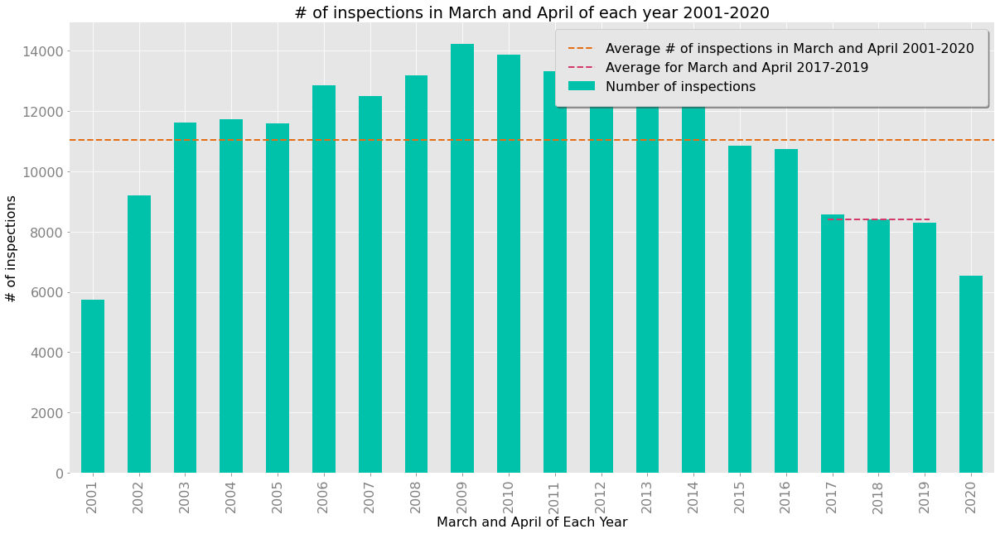

In [ ]:
charter(eval_data, 'ACTUAL_END_DATE', "%m-%d-%Y", mnth_name, 'ACTIVITY_TYPE_DESC', 
        "Number of inspections", "caa_inspections.csv", "# of inspections", "count")

## What have facilities reported releasing into the air?
Air pollution is associated with greater virulence of COVID-19. What are facilities releasing into the air in spite of this greater risk to human life?

We'll start by looking at those facilities that were found to be in violation for their emissions.

In [ ]:
air_data = None
try:
    sql = 'select * from "ICIS-AIR_VIOLATION_HISTORY" where "HPV_DAYZERO_DATE" like \'03-%\' or "HPV_DAYZERO_DATE" like \'04-%\''

    air_data = get_data( sql, "pgm_sys_id" )

    # Remove "FACIL" violations, which are paperwork violations according to: https://19january2017snapshot.epa.gov/sites/production/files/2013-10/documents/frvmemo.pdf
    air_data = air_data.loc[(air_data["POLLUTANT_DESCS"]!="FACIL")]
except EmptyDataError:
    print( "No data found")
air_data

select * from "ICIS-AIR_VIOLATION_HISTORY" where "HPV_DAYZERO_DATE" like '03-%' or "HPV_DAYZERO_DATE" like '04-%'
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%2A+from+%22ICIS-AIR_VIOLATION_HISTORY%22+where+%22HPV_DAYZERO_DATE%22+like+%2703-%25%27+or+%22HPV_DAYZERO_DATE%22+like+%2704-%25%27&pg


,PGM_SYS_ID,ACTIVITY_ID,AGENCY_TYPE_DESC,STATE_CODE,AIR_LCON_CODE,COMP_DETERMINATION_UID,ENF_RESPONSE_POLICY_CODE,PROGRAM_CODES,PROGRAM_DESCS,POLLUTANT_CODES,POLLUTANT_DESCS,EARLIEST_FRV_DETERM_DATE,HPV_DAYZERO_DATE,HPV_RESOLVED_DATE
1,IL000031806AAY,3400337992,U.S. EPA,NaN,NaN,05000F0000170310238400015,HPV,CAANESH,National Emission Standards for Hazardous Air ...,300000183,Benzene,NaN,04-26-1999,11-30-2004
2,IL000031600ASD,3400337995,U.S. EPA,NaN,NaN,05000F0000170310124900094,HPV,CAATVP,Title V Permits,300000243,VOLATILE ORGANIC COMPOUNDS (VOCS),NaN,04-16-2001,07-29-2003
3,IL000031096AKZ,3400338004,U.S. EPA,NaN,NaN,05000F0000170310048100018,HPV,CAATVP,Title V Permits,300000243,VOLATILE ORGANIC COMPOUNDS (VOCS),NaN,04-30-2001,03-31-2004
4,IL000119813AAI,3400338016,State,IL,NaN,IL000A0000171190015300047,HPV,CAASIP,State Implementation Plan for National Primary...,300000319,PARTICULATE MATTER < 10 UM,NaN,04-28-1989,06-09-1993
5,IL000119813AAI,3400338020,State,IL,NaN,IL000A0000171190015300071,HPV,CAANESH,National Emission Standards for Hazardous Air ...,300000183,Benzene,NaN,03-10-1992,08-04-1995
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6938,CABAA324110,3602047698,Local,CA,BAA,CABAAA78712,HPV,CAATVP,Title V Permits,NaN,NaN,03-18-2016,03-18-2016,11-05-2018
6939,CABAA324110,3602048636,Local,CA,BAA,CABAAA78740,HPV,CAATVP,Title V Permits,NaN,NaN,03-21-2016,03-21-2016,11-05-2018
6940,CABAA324110,3602049615,Local,CA,BAA,CABAAA78796,HPV,CAATVP,Title V Permits,NaN,NaN,03-10-2015,03-10-2015,01-12-2018
6941,CABAA424710,3602050949,Local,CA,BAA,CABAAA78846,HPV,CAATVP,Title V Permits,NaN,NaN,04-12-2016,04-12-2016,01-31-2018


#### Chart emissions violations
The height of each bar indicates how many emissions violations there have been. The orange line shows the average number of emissions violations since 2001, and the pink line indicates the average for the past three years.

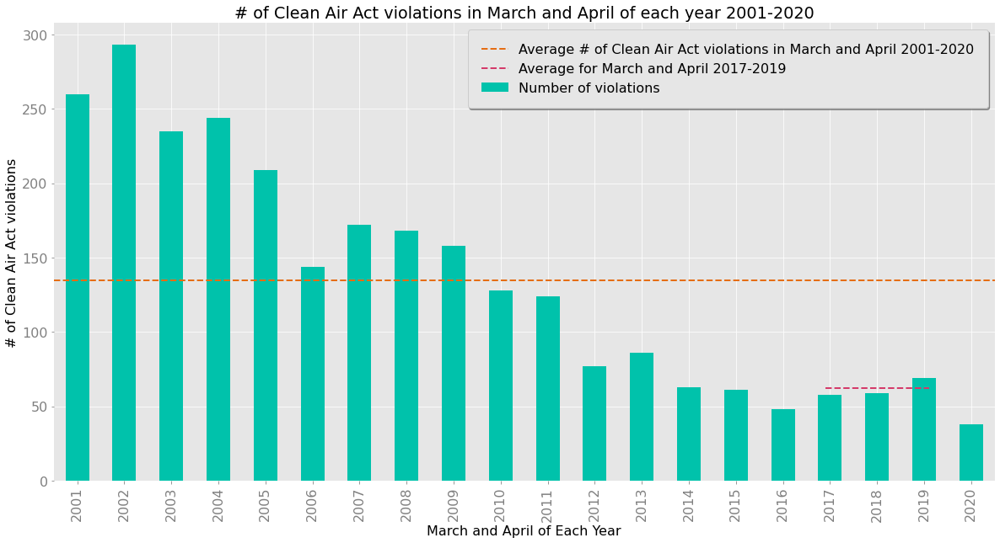

In [ ]:
charter(air_data, 'HPV_DAYZERO_DATE', "%m-%d-%Y", mnth_name, 'ENF_RESPONSE_POLICY_CODE', 
        "Number of violations", "air_violations_total.csv", "# of Clean Air Act violations", "count")

#### Let's focus on March and April for just this year (2020) and break it down by type of pollutant whose levels were exceeded.
In other words, we'll zoom in on the right-most bar in the above chart and show what pollutants facilities released, causing these Clean Air Act violations.

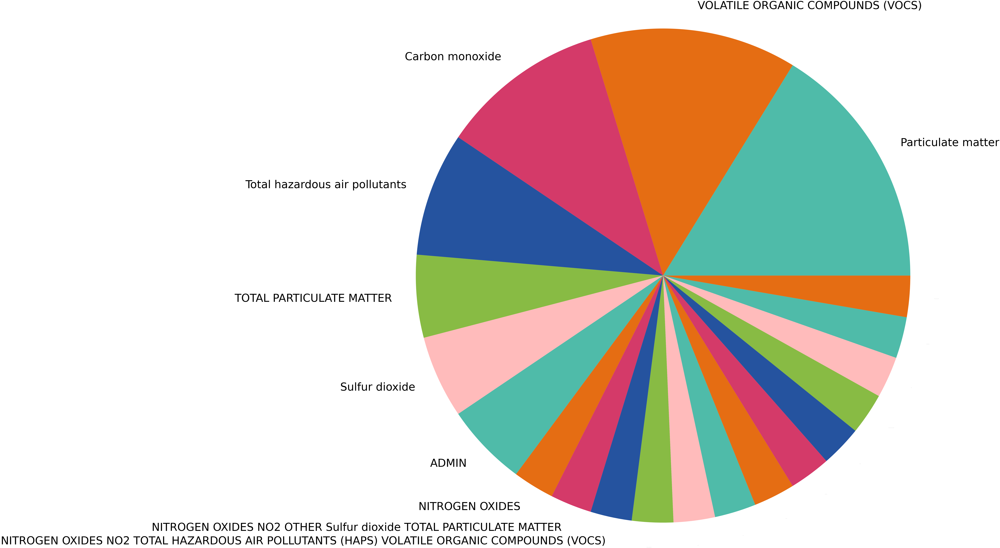

In [ ]:
latest = air_data[(air_data["HPV_DAYZERO_DATE"] >= '2020')]

pollutants = latest.groupby(['POLLUTANT_DESCS'])[['ACTIVITY_ID']].count()
pollutants = pollutants.rename(columns={'ACTIVITY_ID': "Violations"})
pollutants = pollutants.sort_values(by='Violations', ascending=False)

fig = plt.figure(1, figsize=(20,20))
ax = fig.add_subplot(111)
wedges, labels = ax.pie(pollutants["Violations"], labels = pollutants.index, radius = 5);
for pos,lab in enumerate(labels):
    if pos < 10:
        lab.set_fontsize(96)
    else:
        lab.set_fontsize(0)

#### Where are these facilities that exceeded their permits?
Even if, on the whole, there are fewer exceedances, the places that are emitting more pollutants are important to track.

Run the next two cells to set up the analysis.

In [ ]:
# Get everything we will need from ECHO_EXPORTER in a single DB query.
# We can then use the full dataframe to specialize views of it.
full_echo_data = None
column_mapping = {
    '"REGISTRY_ID"': str,
    '"FAC_NAME"': str,
    '"FAC_LAT"': float,
    '"FAC_LONG"': float,
    '"FAC_PERCENT_MINORITY"': float,
    '"AIR_IDS"': str,
    '"NPDES_IDS"': str,
    '"CAA_QTRS_WITH_NC"': float,
    '"CWA_QTRS_WITH_NC"': float,
    '"FAC_QTRS_WITH_NC"': float,
    '"DFR_URL"': str,
    '"AIR_FLAG"': str,
    '"NPDES_FLAG"': str,
    '"GHG_CO2_RELEASES"': float
}
# not currently using: "FAC_INFORMAL_COUNT", "FAC_FORMAL_ACTION_COUNT"
column_names = list( column_mapping.keys() )
columns_string = ','.join( column_names )
sql = 'select ' + columns_string + ' from "ECHO_EXPORTER" where "AIR_FLAG" = \'Y\' or "NPDES_FLAG" = \'Y\''
try:
    # Don't index.
    full_echo_data = get_data( sql )
except EmptyDataError:
    print("\nThere are no EPA facilities for this query.\n")

select "REGISTRY_ID","FAC_NAME","FAC_LAT","FAC_LONG","FAC_PERCENT_MINORITY","AIR_IDS","NPDES_IDS","CAA_QTRS_WITH_NC","CWA_QTRS_WITH_NC","FAC_QTRS_WITH_NC","DFR_URL","AIR_FLAG","NPDES_FLAG","GHG_CO2_RELEASES" from "ECHO_EXPORTER" where "AIR_FLAG" = 'Y' or "NPDES_FLAG" = 'Y'
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%22REGISTRY_ID%22%2C%22FAC_NAME%22%2C%22FAC_LAT%22%2C%22FAC_LONG%22%2C%22FAC_PERCENT_MINORITY%22%2C%22AIR_IDS%22%2C%22NPDES_IDS%22%2C%22CAA_QTRS_WITH_NC%22%2C%22CWA_QTRS_WITH_NC%22%2C%22FAC_QTRS_WITH_NC%22%2C%22DFR_URL%22%2C%22AIR_FLAG%22%2C%22NPDES_FLAG%22%2C%22GHG_CO2_RELEASES%22+from+%22ECHO_EXPORTER%22+where+%22AIR_FLAG%22+%3D+%27Y%27+or+%22NPDES_FLAG%22+%3D+%27Y%27&pg


In [ ]:
latest = air_data[(air_data["HPV_DAYZERO_DATE"] >= '2020')]

# Pull out Ids to match ECHO_EXPORTER
ids = latest['PGM_SYS_ID'].unique()

if (len(latest.index)>0):
    # Get facility information from ECHO
    air_echo_data = full_echo_data[ full_echo_data['AIR_FLAG'] == 'Y' ].copy().reset_index( drop=True )
    # Filter ECHO EXPORTER data to rows containing AIR_IDs from latest / air_data
    idxs=set() # Use a set to get unique index positions in ECHO_EXPORTER (i.e. unique facilities)
    for index,value in air_echo_data["AIR_IDS"].items(): # For each record in E_E
        for i in value.split(): # For each NPDES_ID in the record
            if i in ids: # If the AIR_ID is in the list of non-reporters
                idxs.add(index) # Add its E_E position
    idxs=list(idxs)
    latest = air_echo_data.iloc[idxs,:] # Instead of join, just use E_E, since we don't need the reporting details to map facilities
    qnc = latest # For later analysis of non-compliance trends
    print(latest)
    
else:
    print("Actually, there were no permit exceedences for %s" %(mnth_name))

         REGISTRY_ID  ... GHG_CO2_RELEASES
116738  1.100004e+11  ...        4054169.0
17411   1.100123e+11  ...              NaN
203907  1.100570e+11  ...              NaN
17545   1.100133e+11  ...        5336375.0
141707  1.100003e+11  ...        1185364.0
16401   1.100012e+11  ...              NaN
43685   1.100020e+11  ...              NaN
42151   1.100013e+11  ...          95720.0
23336   1.100420e+11  ...              NaN
42416   1.100641e+11  ...              NaN
181425  1.100004e+11  ...              NaN
222773  1.100420e+11  ...         916192.0
222902  1.100004e+11  ...              NaN
39097   1.100004e+11  ...              NaN
163770  1.100004e+11  ...        4813659.0
58684   1.100019e+11  ...              NaN
36031   1.100435e+11  ...              NaN
63295   1.100006e+11  ...         837450.0
120639  1.100004e+11  ...              NaN
30271   1.100105e+11  ...              NaN
223810  1.100669e+11  ...        7314507.0
159685  1.100003e+11  ...        5386301.0
25030   1.1

#### Make the map!
The map shows us all the facilities that report emitting more than their permitted levels in March and April 2020.

In [ ]:
missing = latest[(np.isnan(latest["FAC_LAT"])) | (np.isnan(latest["FAC_LONG"]))]
count = missing.index.unique()
print("There are "+str(len(count))+" facilities we can't map because they have incomplete data")
# Filter to remove NaNs - missing data!
latest = latest[~(np.isnan(latest["FAC_LAT"])) | ~(np.isnan(latest["FAC_LONG"]))]
print("There are "+str(len(latest))+" facilities mapped below.")
map_of_facilities = mapper(latest)
map_of_facilities

There are 0 facilities we can't map because they have incomplete data
There are 38 facilities mapped below.


#### Of these known violators, how many quarters have they spent in non-compliance recently?
These may be habitually "bad actors" who should not be let off the hook (but likely will be given EPA's non-enforcement policy)

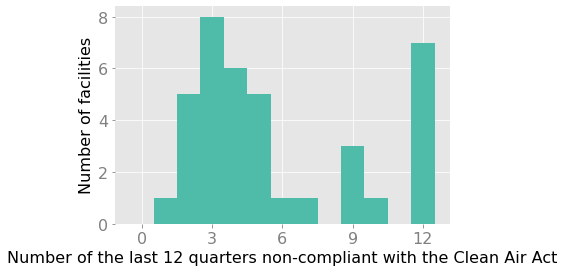

In [ ]:
bad_actors = qnc.groupby(qnc.index)[["CAA_QTRS_WITH_NC"]].mean()
bad_actors = bad_actors[~(np.isnan(bad_actors["CAA_QTRS_WITH_NC"]))]

plt.hist(bad_actors["CAA_QTRS_WITH_NC"], density=False, bins=np.arange(14)-0.5);
plt.xticks([0,3,6,9,12])
plt.ylabel('Number of facilities')
plt.xlabel('Number of the last 12 quarters non-compliant with the Clean Air Act');

---

## What are facilities releasing into the water?

*NOTE*: Because there are so many facilities that discharge into waters of the US, there's a lot of data! The following cell may take a little while to run.

In [ ]:
# Find facilities with pollutant exceedences
exceeds = None
try:
    sql = 'select "NPDES_ID", "EXCEEDENCE_PCT", "MONITORING_PERIOD_END_DATE", "PARAMETER_DESC"' + \
        ' from "NPDES_EFF_VIOLATIONS" where "EXCEEDENCE_PCT" > 0 and ("MONITORING_PERIOD_END_DATE" like \'03/%\' or "MONITORING_PERIOD_END_DATE" like \'04/%\')'

    dis_data = get_data( sql, "NPDES_ID" )
    exceeds = dis_data 
except EmptyDataError:
    print( "No data found")
exceeds

select "NPDES_ID", "EXCEEDENCE_PCT", "MONITORING_PERIOD_END_DATE", "PARAMETER_DESC" from "NPDES_EFF_VIOLATIONS" where "EXCEEDENCE_PCT" > 0 and ("MONITORING_PERIOD_END_DATE" like '03/%' or "MONITORING_PERIOD_END_DATE" like '04/%')
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%22NPDES_ID%22%2C+%22EXCEEDENCE_PCT%22%2C+%22MONITORING_PERIOD_END_DATE%22%2C+%22PARAMETER_DESC%22+from+%22NPDES_EFF_VIOLATIONS%22+where+%22EXCEEDENCE_PCT%22+%3E+0+and+%28%22MONITORING_PERIOD_END_DATE%22+like+%2703%2F%25%27+or+%22MONITORING_PERIOD_END_DATE%22+like+%2704%2F%25%27%29&pg


,EXCEEDENCE_PCT,MONITORING_PERIOD_END_DATE,PARAMETER_DESC
NPDES_ID,,,
NY0033154,8,03/31/2003,"BOD, carbonaceous [5 day, 20 C]"
TX0006637,29,04/30/1998,"Solids, total suspended"
OH0107735,25,03/31/2007,"Solids, total suspended"
OH0011193,6,04/30/2002,"Oxygen, dissolved [DO]"
VI0040029,67,03/31/2006,"BOD, 5-day, 20 deg. C"
...,...,...,...
OH0021849,8,03/31/2015,"Mercury, total low level"
NY0200841,17,03/31/2005,Oil & Grease
IL0001473,40,04/30/2007,"Solids, total suspended"


#### Chart Clean Water Act exceedances
Are facilities exceeding their permits more this month in 2020 than previous years? Like with air emissions and monitoring, we need to compare month-month (e.g. March/April 2019 to March/April 2020) because there is a seasonality to many discharges.

The height of each bar will indicate how many pollution permits have been exceeded, while the orange line will show us the average number of these since 2001 and the pink line indicates the average for the past three years.

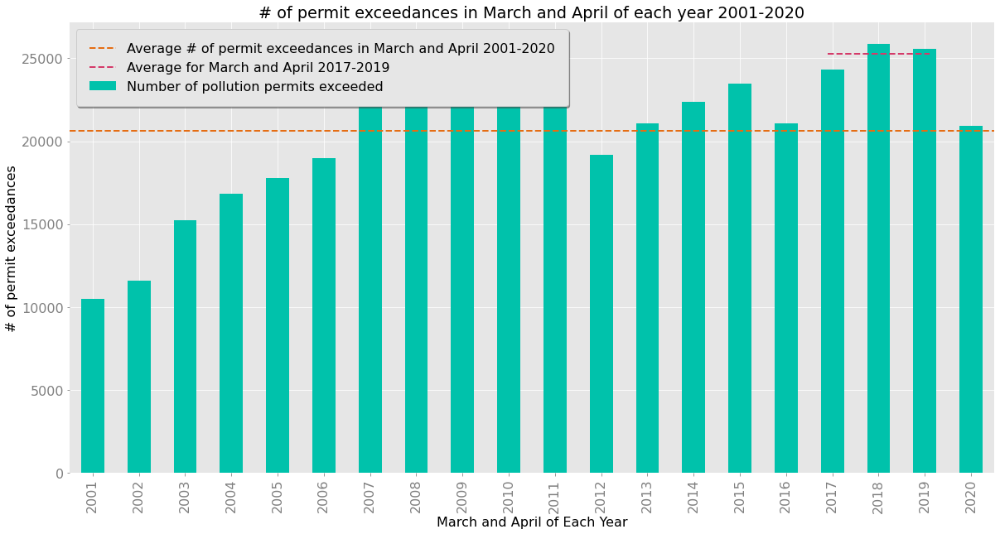

In [ ]:
charter(exceeds, 'MONITORING_PERIOD_END_DATE', "%m/%d/%Y", mnth_name, 'EXCEEDENCE_PCT', 
        "Number of pollution permits exceeded", "cwa_violations_total.csv", 
        "# of permit exceedances", "count")

#### Let's look at March and April for just this year (2020) and break it down by type of pollutant.
That is, we're going to zoom in on the rightmost bar in the bar charts above.

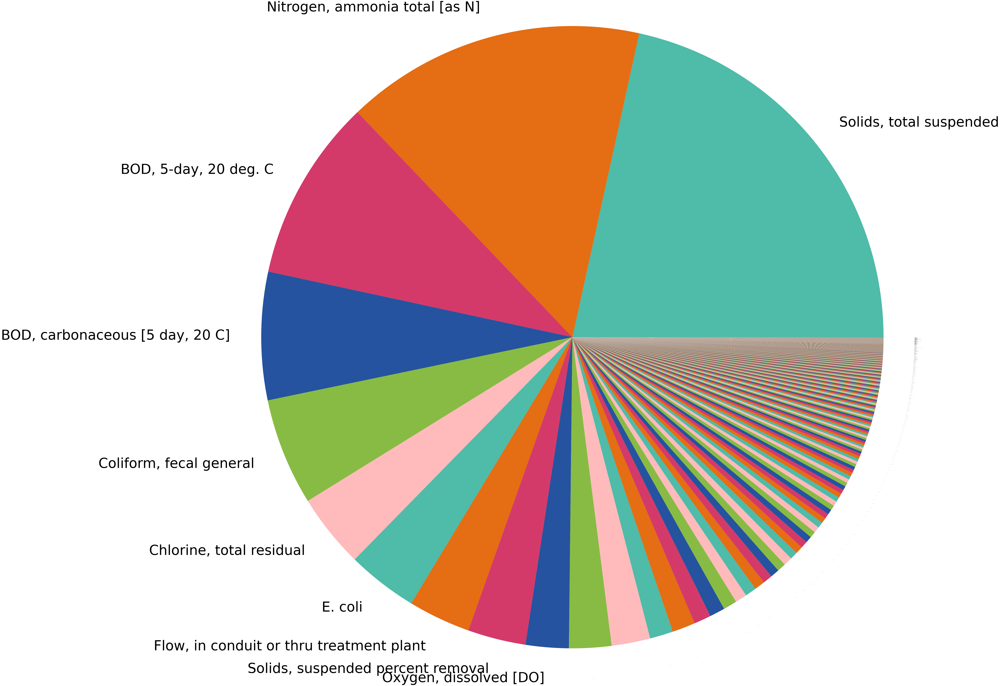

In [ ]:
latest = exceeds[(exceeds['MONITORING_PERIOD_END_DATE'] >= '2020')]

pollutants = latest.groupby(['PARAMETER_DESC'])[['MONITORING_PERIOD_END_DATE']].count()
pollutants = pollutants.rename(columns={'MONITORING_PERIOD_END_DATE': "Violations"})
pollutants = pollutants.sort_values(by='Violations', ascending=False)

fig = plt.figure(1, figsize=(20,20))
ax = fig.add_subplot(111)
wedges, labels = ax.pie(pollutants["Violations"], labels = pollutants.index, radius = 5);
for pos,lab in enumerate(labels):
    if pos < 10:
        lab.set_fontsize(96)
    else:
        lab.set_fontsize(0)

#### Where are the facilities that are currently exceeding their Clean Water Act emissions?
Remember, these are only the facilities that chose to report exceedances. Under the current policy, facilities can be not reporting at all, legally.

In [ ]:
latest = exceeds[(exceeds['MONITORING_PERIOD_END_DATE'] >= '2020')]

# Pull out Ids to match ECHO_EXPORTER
ids = latest.index.unique()

if (len(latest.index)>0):
    # Get facility information from ECHO
    water_echo_data = full_echo_data[ full_echo_data['NPDES_FLAG'] == 'Y' ].copy().reset_index( drop=True )

    # Filter ECHO EXPORTER data to rows containing pgm_sys_ids from latest  
    idxs=set() # Use a set to get unique index positions in ECHO_EXPORTER (i.e. unique facilities)
    for index,value in water_echo_data["NPDES_IDS"].items(): # For each record in E_E
        for i in value.split(): # For each NPDES_ID in the record
            if i in ids: # If the NPDES_ID is in the list of non-reporters
                idxs.add(index) # Add its E_E position
    idxs=list(idxs)
    latest = water_echo_data.iloc[idxs,:] # Instead of join, just use E_E, since we don't need the reporting details to map facilities
    qnc = latest # For later analysis of non-compliance trends
    print(latest)
    
else:
    print("Actually, there were no reporting violations for %s" %(mnth_name))    

         REGISTRY_ID  ... GHG_CO2_RELEASES
327696  1.100110e+11  ...              NaN
622612  1.100098e+11  ...              NaN
196629  1.100647e+11  ...              NaN
131100  1.100707e+11  ...              NaN
393245  1.100101e+11  ...              NaN
...              ...  ...              ...
458713  1.100244e+11  ...              NaN
622563  1.100231e+11  ...              NaN
458732  1.100108e+11  ...              NaN
491506  1.100068e+11  ...              NaN
425979  1.100063e+11  ...              NaN

[7089 rows x 14 columns]


In [ ]:
missing = latest[(np.isnan(latest["FAC_LAT"])) | (np.isnan(latest["FAC_LONG"]))]
count = missing.index.unique()
print("There are "+str(len(count))+" facilities we can't map because they have incomplete data")
latest = latest[~(np.isnan(latest["FAC_LAT"])) | ~(np.isnan(latest["FAC_LONG"]))] # Filter to remove NaNs - missing data!
print("There are "+str(len(latest))+" facilities mapped below.")
map_of_facilities = mapper(latest)
map_of_facilities

There are 0 facilities we can't map because they have incomplete data
There are 7089 facilities mapped below.


#### Of these known violators, how many quarters have they spent in non-compliance recently?
These may be habitually "bad actors" who should not be let off the hook (but likely will be given EPA's non-enforcement policy)

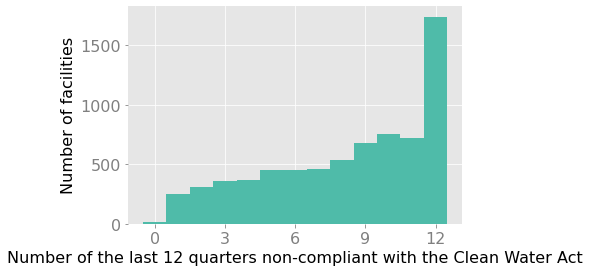

In [ ]:
bad_actors = qnc.groupby(qnc.index)[["CWA_QTRS_WITH_NC"]].mean()
bad_actors = bad_actors[~(np.isnan(bad_actors["CWA_QTRS_WITH_NC"]))]

plt.hist(bad_actors["CWA_QTRS_WITH_NC"], density=False, bins=np.arange(14)-0.5);
plt.xticks([0,3,6,9,12])
plt.ylabel('Number of facilities')
plt.xlabel('Number of the last 12 quarters non-compliant with the Clean Water Act');

## Are facilities monitoring and reporting water quality?
We'll look at how facilities regulated under the Clean Water Act have altered their required monitoring practices.

Run the code in the cells below, which will query our copy of the ECHO database and pull information on regulated facilities.

First, we'll find records of facilities violating their permits due to missing reports such as Annual Inspection Certificates and CAFO annual reports. In this case, the "N" we are looking for in our query does NOT mean no - it just is a code for the kind of violation event we're interested in (non-reporting).

Second, we'll find records of facilities violating their permits due to "Non-Receipt of DMR (Discharge Monitoring Reports)/Schedule Report" and are required by the CWA's National Pollutant Discharge Elimination System (NPDES).

Not submitting these reports on schedule can lead to "Reportable Non-Compliance" with NPDES and CWA. According to the EPA, "DMR values not received within 31 days of the DMR form due date result in the generation of a violation code (D80 or D90). ICIS-NPDES identifies these DMR non-receipt violations and automatically creates violation codes for the missing DMR values with monitoring requirements (D80) and missing DMR values with effluent limits (D90). EPA's data sharing policy allows states a 40-day window to report DMR values to EPA's data system; therefore, DMR values reported on time to state agencies and shared with EPA within 40 days do not contribute to permit level noncompliance status."

In [ ]:
report_data = None
try:
    sql = 'select "NPDES_ID", "SCHEDULE_DATE", "RNC_DETECTION_CODE"' + \
        ' from "NPDES_PS_VIOLATIONS" where "RNC_DETECTION_CODE" = \'N\' and ' + \
        ' ("SCHEDULE_DATE" like \'03/%\' or "SCHEDULE_DATE" like \'04/%\')'
    report_data = get_data( sql, "NPDES_ID" )
except EmptyDataError:
    print( "No data found")
report_data

select "NPDES_ID", "SCHEDULE_DATE", "RNC_DETECTION_CODE" from "NPDES_PS_VIOLATIONS" where "RNC_DETECTION_CODE" = 'N' and  ("SCHEDULE_DATE" like '03/%' or "SCHEDULE_DATE" like '04/%')
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%22NPDES_ID%22%2C+%22SCHEDULE_DATE%22%2C+%22RNC_DETECTION_CODE%22+from+%22NPDES_PS_VIOLATIONS%22+where+%22RNC_DETECTION_CODE%22+%3D+%27N%27+and++%28%22SCHEDULE_DATE%22+like+%2703%2F%25%27+or+%22SCHEDULE_DATE%22+like+%2704%2F%25%27%29&pg


,SCHEDULE_DATE,RNC_DETECTION_CODE
NPDES_ID,,
PR0023990,03/01/1995,N
NM0030317,04/01/2006,N
IN0040835,03/01/1999,N
NM0023311,04/01/2001,N
IN0025160,04/01/1996,N
...,...,...
COX631077,04/01/2019,N
MO0032883,03/31/2019,N
OH0145807,04/01/2019,N


#### Chart this ^ !!!
It's all well and good to have this table, but it's hard to pick out patterns from tabular data. Let's plot it as a histogram in order to see what's going on.

The height of each bar will indicate how many facilities were out of compliance due to missing or late reports, while the orange line will show us the average number of these facilities for since 2001 and the pink line indicates the average for the past three years or so.

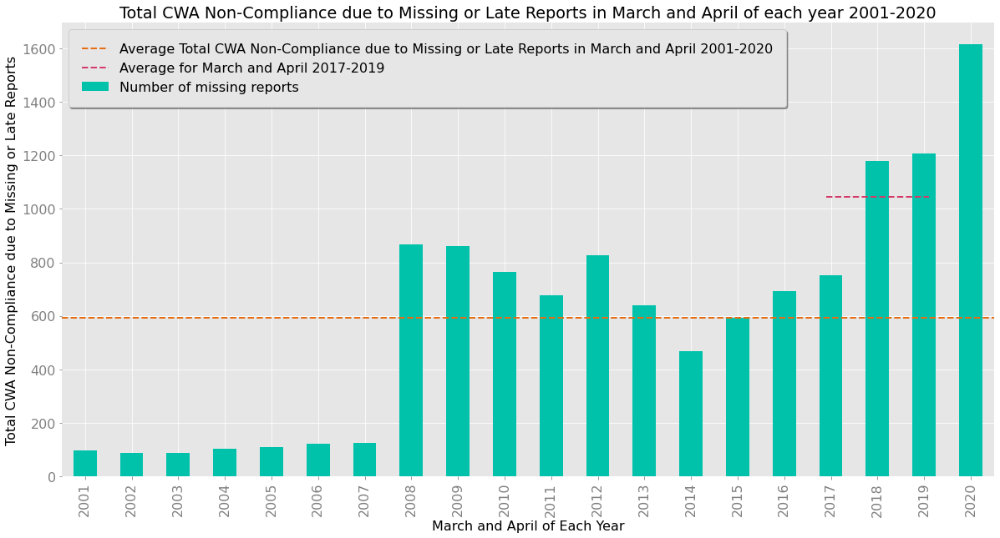

In [ ]:
charter(report_data, 'SCHEDULE_DATE', "%m/%d/%Y",  mnth_name,'RNC_DETECTION_CODE', "Number of missing reports", 
        "cwa_missing_reports.csv", "Total CWA Non-Compliance due to Missing or Late Reports", "count")

#### Which facilities didn't submit reports in March or April of 2020?
First, let's get more information about those facilities.

In [ ]:
latest = report_data[(report_data["SCHEDULE_DATE"] >= "2020")]

# Pull out Ids to match ECHO_EXPORTER
ids = latest.index.unique()

if (len(latest.index)>0):
    # Get facility information from ECHO
    echo_data = full_echo_data[ full_echo_data['NPDES_FLAG'] == 'Y' ].copy().reset_index( drop=True )
    
    idxs=set() # Use a set to get unique index positions in ECHO_EXPORTER (i.e. unique facilities)
    for index,value in echo_data["NPDES_IDS"].items(): # For each record in E_E
        for i in value.split(): # For each NPDES_ID in the record
            if i in ids: # If the NPDES_ID is in the list of non-reporters
                idxs.add(index) # Add its E_E position
    idxs=list(idxs)
    latest = echo_data.iloc[idxs,:] # Instead of join, just use E_E and replace latest, since we don't need the reporting details to map facilities

    print(latest)
    
else:
    print("Actually, there were no reporting violations for %s" %(mnth_name))    

         REGISTRY_ID  ... GHG_CO2_RELEASES
380928  1.100702e+11  ...              NaN
448513  1.100007e+11  ...              NaN
294914  1.100005e+11  ...              NaN
522243  1.100707e+11  ...              NaN
565248  1.100005e+11  ...              NaN
...              ...  ...              ...
194549  1.100108e+11  ...              NaN
450551  1.100704e+11  ...              NaN
251896  1.100702e+11  ...              NaN
499707  1.100151e+11  ...              NaN
133119  1.100299e+11  ...              NaN

[1351 rows x 14 columns]


#### Map them!
Now we'll map those facilities that didn't submit things like Annual Inspection Certifications in March and April of 2020.

In [ ]:
missing = latest[(np.isnan(latest["FAC_LAT"])) | (np.isnan(latest["FAC_LONG"]))]
count = missing.index.unique()
print("There are "+str(len(count))+" facilities we can't map because they have incomplete data")
latest = latest[~(np.isnan(latest["FAC_LAT"])) | ~(np.isnan(latest["FAC_LONG"]))] # Filter to remove NaNs - missing data!
print("There are "+str(len(latest))+" facilities mapped below.")
map_of_facilities = mapper(latest)
map_of_facilities

There are 0 facilities we can't map because they have incomplete data
There are 1351 facilities mapped below.


Now let's look at missing Discharge Monitoring Reports. These really important reports, often submitted monthly, are supposed to include detailed information on for each permitted pollutant.

In [ ]:
sql = 'select "NPDES_ID", "MONITORING_PERIOD_END_DATE", "NODI_CODE", "VIOLATION_CODE", "RNC_DETECTION_CODE"' + \
    ' from "NPDES_EFF_VIOLATIONS" where' + \
    ' "MONITORING_PERIOD_END_DATE" like \'03/%\' or "MONITORING_PERIOD_END_DATE" like \'04/%\''

dmr_data = get_data( sql, "NPDES_ID" )
dmr_data

select "NPDES_ID", "MONITORING_PERIOD_END_DATE", "NODI_CODE", "VIOLATION_CODE", "RNC_DETECTION_CODE" from "NPDES_EFF_VIOLATIONS" where "MONITORING_PERIOD_END_DATE" like '03/%' or "MONITORING_PERIOD_END_DATE" like '04/%'
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%22NPDES_ID%22%2C+%22MONITORING_PERIOD_END_DATE%22%2C+%22NODI_CODE%22%2C+%22VIOLATION_CODE%22%2C+%22RNC_DETECTION_CODE%22+from+%22NPDES_EFF_VIOLATIONS%22+where+%22MONITORING_PERIOD_END_DATE%22+like+%2703%2F%25%27+or+%22MONITORING_PERIOD_END_DATE%22+like+%2704%2F%25%27&pg


,MONITORING_PERIOD_END_DATE,NODI_CODE,VIOLATION_CODE,RNC_DETECTION_CODE
NPDES_ID,,,,
GA0048682,03/31/2006,NaN,D90,K
GA0047759,03/31/2006,NaN,D90,NaN
GAU050119,03/31/2007,NaN,D80,N
MT0021474,04/30/1997,NaN,D90,K
WA0020559,04/30/2019,NaN,D80,K
...,...,...,...,...
MD0054330,04/30/2000,NaN,D90,NaN
MDG520177,03/31/2007,NaN,D80,K
AL0075965,03/31/2005,NaN,D90,K


Process this data a bit.

In [ ]:
x = dmr_data.loc[(dmr_data['VIOLATION_CODE'] == 'D80') | (dmr_data['VIOLATION_CODE'] == 'D90')] #https://echo.epa.gov/tools/data-downloads/icis-npdes-download-summary Required monitoring DMR value overdue / Limited value overdue	
x = x.loc[(x['RNC_DETECTION_CODE'] == 'K') | (x['RNC_DETECTION_CODE'] == 'N')] #https://echo.epa.gov/tools/data-downloads/icis-npdes-download-summary. 	Non-receipt Violation, Non-Monthly Average / Non-Receipt of DMR/Schedule Report

#x = x.loc[(x['MONITORING_PERIOD_END_DATE'].str.contains("03/")) | (x['MONITORING_PERIOD_END_DATE'].str.contains("04/"))]
#z = x.loc[(x['NODI_CODE']=='Z')]
f = x.reset_index()
f["MONITORING_PERIOD_END_DATE"] = pd.to_datetime(f['MONITORING_PERIOD_END_DATE'], format="%m/%d/%Y")
f = f.groupby("MONITORING_PERIOD_END_DATE")[["NPDES_ID"]].agg("nunique")
f = f.resample("Y").sum()
x

,MONITORING_PERIOD_END_DATE,NODI_CODE,VIOLATION_CODE,RNC_DETECTION_CODE
NPDES_ID,,,,
GA0048682,03/31/2006,NaN,D90,K
GAU050119,03/31/2007,NaN,D80,N
MT0021474,04/30/1997,NaN,D90,K
WA0020559,04/30/2019,NaN,D80,K
WY0094277,03/31/2019,NaN,D80,K
...,...,...,...,...
TXG830099,03/31/2006,NaN,D90,K
MDG520177,03/31/2007,NaN,D80,K
AL0075965,03/31/2005,NaN,D90,K


Chart all these missing DMRs, first in total, and then by the number of facilities failing to report them.

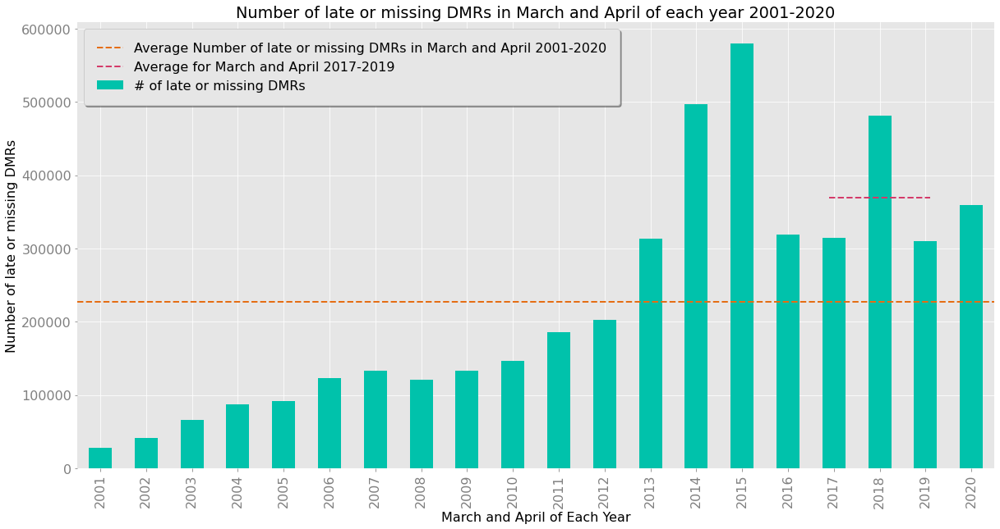

In [ ]:
charter(x, 'MONITORING_PERIOD_END_DATE', "%m/%d/%Y", mnth_name, 'MONITORING_PERIOD_END_DATE', 
        "# of late or missing DMRs", "missing_DMRs.csv", "Number of late or missing DMRs", 
        "count")

Text(0, 0.5, 'Number of facilities with late or missing DMRs')

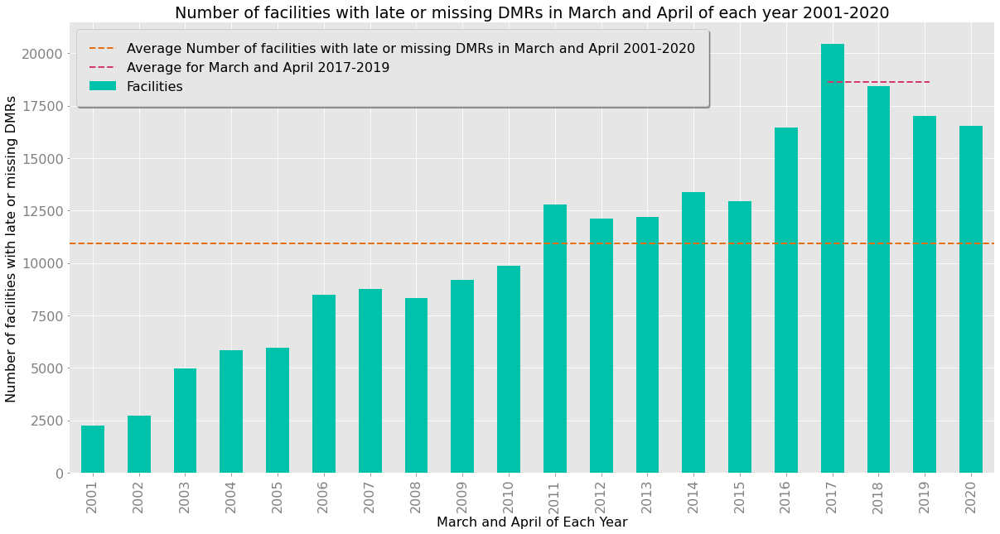

In [ ]:
# Set up some default parameters for graphing
from matplotlib import cycler
colour = "#00C2AB" # The default colour for the barcharts
colors = cycler('color',
                ['#4FBBA9', '#E56D13', '#D43A69',
                 '#25539f', '#88BB44', '#FFBBBB'])
plt.rc('axes', facecolor='#E6E6E6', edgecolor='none',
       axisbelow=True, grid=True, prop_cycle=colors)
plt.rc('grid', color='w', linestyle='solid')
plt.rc('xtick', direction='out', color='gray')
plt.rc('ytick', direction='out', color='gray')
plt.rc('patch', edgecolor='#E6E6E6')
plt.rc('lines', linewidth=2)
font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : 16}
plt.rc('font', **font)
plt.rc('legend', fancybox = True, framealpha=1, shadow=True, borderpad=1)

title ="Number of facilities with late or missing DMRs"
# Organize the data
#f.index = f.index.strftime('%Y') # Make the x axis (date) prettier
f = f.loc[f.index >= '2001']
f= f.rename(columns={"NPDES_ID": "Facilities"})
# Create the chart
ax = f.plot(kind='bar', title = ""+title+" in %s of each year 2001-2020" %(mnth_name), figsize=(20, 10), fontsize=16, color=colour)
ax

# Label trendline
trend=f["Facilities"].mean()
ax.axhline(y=trend, color='#e56d13', linestyle='--', label = "Average "+title+" in %s 2001-2020" %(mnth_name))

# Label the previous three years' trend (2017, 2018, 2019)
trend_month=pd.concat([f.loc["2017"],f.loc["2018"],f.loc["2019"]])
trend_month=trend_month["Facilities"].mean()
ax.axhline(y=trend_month, xmin = .82, xmax=.93, color='#d43a69', linestyle='--', label = "Average for %s 2017-2019" %(mnth_name))

# Label plot
ax.legend()
ax.set_xlabel("March and April of Each Year")
ax.set_ylabel(title)

## Which facilities have officially indicated that they could not monitor and report water quality due to COVID?
Facilities are allowed to indicate to the EPA that they were unable to submit water discharge monitoring reports because of COVID-related reasons.

In [ ]:
### Use NPDES_DMR_FY2020 to show the facilities that indicated they could not monitor and report due to COVID
z_data = None
try:
    sql = 'select *' + \
        ' from "NPDES_DMRS_FY2020" where "NODI_CODE" = \'Z\' and ' + \
        ' ("MONITORING_PERIOD_END_DATE" like \'03/%\' or "MONITORING_PERIOD_END_DATE" like \'04/%\')'

    z_data = get_data( sql, "EXTERNAL_PERMIT_NMBR" )
    count = len(z_data.index.unique())
    print("There are "+str(count)+" permittees that have officially indciated they could not monitor and report on water quality due to COVID. Here are their records:")
except EmptyDataError:
    print( "No data found")
z_data

select * from "NPDES_DMRS_FY2020" where "NODI_CODE" = 'Z' and  ("MONITORING_PERIOD_END_DATE" like '03/%' or "MONITORING_PERIOD_END_DATE" like '04/%')
http://apps.tlt.stonybrook.edu/echoepa/?query=select+%2A+from+%22NPDES_DMRS_FY2020%22+where+%22NODI_CODE%22+%3D+%27Z%27+and++%28%22MONITORING_PERIOD_END_DATE%22+like+%2703%2F%25%27+or+%22MONITORING_PERIOD_END_DATE%22+like+%2704%2F%25%27%29&pg
There are 325 permittees that have officially indciated they could not monitor and report on water quality due to COVID. Here are their records:


,ACTIVITY_ID,VERSION_NMBR,PERM_FEATURE_ID,PERM_FEATURE_NMBR,PERM_FEATURE_TYPE_CODE,LIMIT_SET_ID,LIMIT_SET_DESIGNATOR,LIMIT_SET_SCHEDULE_ID,LIMIT_ID,LIMIT_BEGIN_DATE,LIMIT_END_DATE,NMBR_OF_SUBMISSION,NMBR_OF_REPORT,PARAMETER_CODE,PARAMETER_DESC,MONITORING_LOCATION_CODE,STAY_TYPE_CODE,LIMIT_VALUE_ID,LIMIT_VALUE_TYPE_CODE,LIMIT_VALUE_NMBR,LIMIT_UNIT_CODE,LIMIT_UNIT_DESC,STANDARD_UNIT_CODE,STANDARD_UNIT_DESC,LIMIT_VALUE_STANDARD_UNITS,STATISTICAL_BASE_CODE,STATISTICAL_BASE_TYPE_CODE,LIMIT_VALUE_QUALIFIER_CODE,OPTIONAL_MONITORING_FLAG,LIMIT_SAMPLE_TYPE_CODE,LIMIT_FREQ_OF_ANALYSIS_CODE,STAY_VALUE_NMBR,LIMIT_TYPE_CODE,DMR_EVENT_ID,MONITORING_PERIOD_END_DATE,DMR_SAMPLE_TYPE_CODE,DMR_FREQ_OF_ANALYSIS_CODE,REPORTED_EXCURSION_NMBR,DMR_FORM_VALUE_ID,VALUE_TYPE_CODE,DMR_VALUE_ID,DMR_VALUE_NMBR,DMR_UNIT_CODE,DMR_UNIT_DESC,DMR_VALUE_STANDARD_UNITS,DMR_VALUE_QUALIFIER_CODE,VALUE_RECEIVED_DATE,DAYS_LATE,NODI_CODE,EXCEEDENCE_PCT,NPDES_VIOLATION_ID,VIOLATION_CODE,RNC_DETECTION_CODE,RNC_DETECTION_DATE,RNC_RESOLUTION_CODE,RNC_RESOLUTION_DATE
EXTERNAL_PERMIT_NMBR,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
PA0031992,3600087629,0,3600025406,001,EXO,3600469902,Q,3600673735,3604826639,03/01/2015,02/29/2020,3.0,3,00630,Nitrite + Nitrate total [as N],1,NaN,3608187933,C2,NaN,19,mg/L,19,mg/L,NaN,QA,AVG,NaN,N,08,01/90,NaN,ENF,3614446973,03/31/2020,NaN,NaN,NaN,3809326140,C2,3714400198,NaN,NaN,NaN,NaN,NaN,04/30/2020,2.0,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PA0031992,3600087629,0,3600025406,001,EXO,3600469902,Q,3600673735,3604826641,03/01/2015,02/29/2020,3.0,3,00610,"Nitrogen, ammonia total [as N]",1,NaN,3608187936,C2,NaN,19,mg/L,19,mg/L,NaN,QA,AVG,NaN,N,08,01/90,NaN,ENF,3614446973,03/31/2020,NaN,NaN,NaN,3809326363,C2,3714400189,NaN,NaN,NaN,NaN,NaN,04/30/2020,2.0,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PA0031992,3600087629,0,3600025406,001,EXO,3600469902,Q,3600673735,3604826623,03/01/2015,02/29/2020,3.0,3,00600,"Nitrogen, total [as N]",1,NaN,3608187912,C2,NaN,19,mg/L,19,mg/L,NaN,QA,AVG,NaN,N,08,01/90,NaN,ENF,3614446973,03/31/2020,NaN,NaN,NaN,3809325441,C2,3714400188,NaN,NaN,NaN,NaN,NaN,04/30/2020,2.0,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PA0031992,3600087629,0,3600025406,001,EXO,3600469902,Q,3600673735,3604826631,03/01/2015,02/29/2020,3.0,3,00625,"Nitrogen, Kjeldahl, total [as N]",1,NaN,3608187922,C2,NaN,19,mg/L,19,mg/L,NaN,QA,AVG,NaN,N,08,01/90,NaN,ENF,3614446973,03/31/2020,NaN,NaN,NaN,3809325721,C2,3714400192,NaN,NaN,NaN,NaN,NaN,04/30/2020,2.0,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PA0031992,3600087629,0,3600025406,001,EXO,3600469902,Q,3600673735,3604826635,03/01/2015,02/29/2020,3.0,3,00665,"Phosphorus, total [as P]",1,NaN,3608187927,C2,NaN,19,mg/L,19,mg/L,NaN,QA,AVG,NaN,N,08,01/90,NaN,ENF,3614446973,03/31/2020,NaN,NaN,NaN,3809325949,C2,3714400203,NaN,NaN,NaN,NaN,NaN,04/30/2020,2.0,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NYR00G305,3602006218,0,3600423532,001,EXO,3600466921,Q,3600669478,3604792008,10/01/2019,02/28/2023,3.0,3,00556,Oil & Grease,1,NaN,3608122510,C3,15.0,19,mg/L,19,mg/L,15.0,DD,MAX,<=,N,GR,01/90,NaN,ALR,3614345049,03/31/2020,NaN,NaN,NaN,3807997052,C3,3712655668,NaN,NaN,NaN,NaN,NaN,04/28/2020,NaN,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NYR00G305,3602006218,0,3600423533,002,EXO,3600466922,Q,3600669479,3604792012,10/01/2019,02/28/2023,3.0,3,81017,Chemical Oxygen Demand [COD],1,NaN,3608122514,C3,120.0,19,mg/L,19,mg/L,120.0,DD,MAX,<=,N,GR,01/90,NaN,ALR,3614345061,03/31/2020,NaN,NaN,NaN,3807997077,C3,3712655667,NaN,NaN,NaN,NaN,NaN,04/28/2020,NaN,Z,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NYR00G305,3602006218,0,3600423535,004,EXO,3600466924,Q,3600669481,3604792017,10/01/2019,02/28/2023,3.0,3,81017,Chemical Oxygen Demand [COD],1,NaN,3608122518,C3,120.0,19,mg/L,19,mg/L,120.0,DD,MAX,<=,N,GR,01/90,NaN,ALR,3614345143,03/31/2020,NaN,NaN,NaN,3807997705,C3,3712655683,NaN,NaN,NaN,NaN,NaN,04

#### What kinds of water pollutants were these facilities not able to report on?

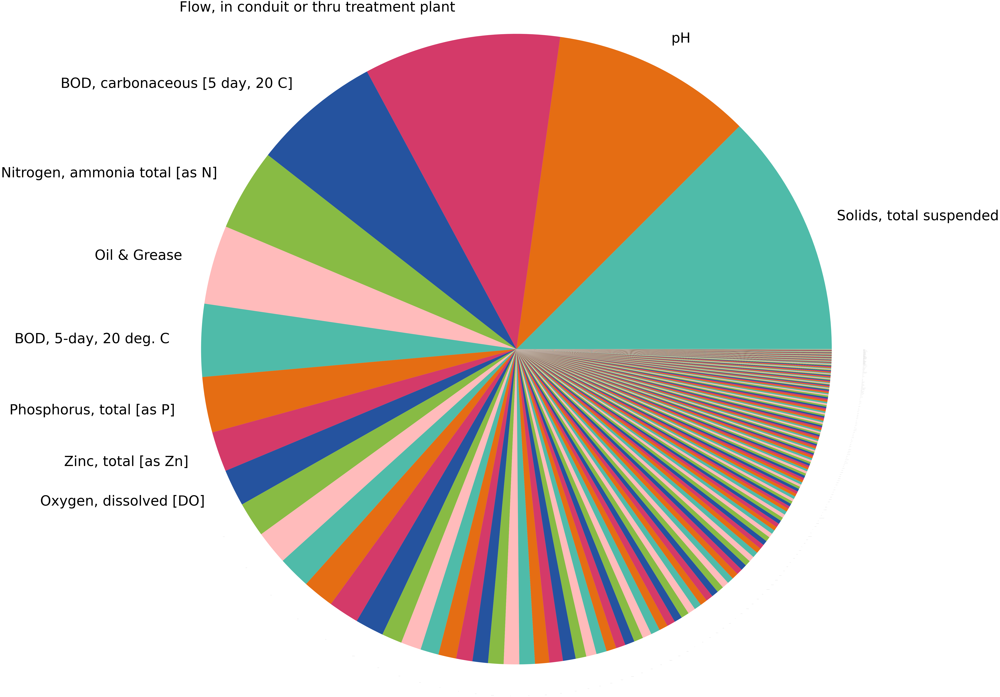

In [ ]:
pollutants = z_data.groupby(['PARAMETER_DESC'])[['MONITORING_PERIOD_END_DATE']].count()
pollutants = pollutants.rename(columns={'MONITORING_PERIOD_END_DATE': "Violations"})
pollutants = pollutants.sort_values(by='Violations', ascending=False)

fig = plt.figure(1, figsize=(20,20))
ax = fig.add_subplot(111)
wedges, labels = ax.pie(pollutants["Violations"], labels = pollutants.index, radius = 5);
for pos,lab in enumerate(labels):
    if pos < 10:
        lab.set_fontsize(96)
    else:
        lab.set_fontsize(0)

#### Where are these facilities?

In [ ]:
latest = z_data

# Pull out Ids to match ECHO_EXPORTER
ids = latest.index.unique()

if (len(latest.index)>0):
    # Get facility information from ECHO
    echo_data = full_echo_data[ full_echo_data['NPDES_FLAG'] == 'Y' ].copy().reset_index( drop=True )
    # Filter ECHO EXPORTER data to rows containing NPDES IDs from latest / z_data  
    idxs=set() # Use a set to get unique index positions in ECHO_EXPORTER (i.e. unique facilities)
    for index,value in echo_data["NPDES_IDS"].items(): # For each record in E_E
        for i in value.split(): # For each NPDES_ID in the record
            if i in ids: # If the NPDES_ID is in the list of non-reporters
                idxs.add(index) # Add its E_E position
    idxs=list(idxs)
    latest = echo_data.iloc[idxs,:] # Instead of join, just use E_E and replace latest, since we don't need the reporting details to map facilities
    latest
else:
    print("Actually, there were no reporting violations for %s" %(mnth_name))    

In [ ]:
missing = latest[(np.isnan(latest["FAC_LAT"])) | (np.isnan(latest["FAC_LONG"]))]
count = missing.index.unique()
print("There are "+str(len(count))+" facilities we can't map because they have incomplete data")
latest = latest[~(np.isnan(latest["FAC_LAT"])) | ~(np.isnan(latest["FAC_LONG"]))] # Filter to remove NaNs - missing data!
print("There are "+str(len(latest))+" facilities mapped below.")
map_of_facilities = mapper(latest)
map_of_facilities

There are 0 facilities we can't map because they have incomplete data
There are 321 facilities mapped below.
